In [49]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import plotly.express as px

Read the dataset

In [6]:
housing_price = pd.read_csv("Housing_Price.csv")
housing_price

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500.0
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500.0
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500.0
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000.0
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2914,2915,160,RM,21.0,1936,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,6,2006,WD,Normal,NaN
2915,2916,160,RM,21.0,1894,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,4,2006,WD,Abnorml,NaN
2916,2917,20,RL,160.0,20000,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2006,WD,Abnorml,NaN
2917,2918,85,RL,62.0,10441,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,MnPrv,Shed,700,7,2006,WD,Normal,NaN


Dummify the categorical viriables

In [76]:
housing_price['MSZoning'] = housing_price['MSZoning'].map({'RL':0,'RM':1,'FV':2,'RH':3,'C (all)':4})
housing_price['Street'] = housing_price['Street'].map({'Pave':0,'Grvl':1})
housing_price['Alley'] = housing_price['Alley'].map({'Pave':0,'Grvl':1})
housing_price['LotShape'] = housing_price['LotShape'].map({'Reg':0,'IR1':1,'IR2':2,'IR3':3})
housing_price['LandContour'] = housing_price['LandContour'].map({'Lvl ':0,'HLS':1,'Bnk':2,'Low':3})
housing_price['Utilities'] = housing_price['Utilities'].map({'AllPub':0,'NoSeWa':1})
housing_price['LotConfig'] = housing_price['LotConfig'].map({'Inside':0,'Corner':1,'CulDSac':2,'FR2':3,'FR3':4})
housing_price['LandSlope'] = housing_price['LandSlope'].map({'Gtl':0,'Mod':1,'Sev':2})
housing_price['Neighborhood'] = housing_price['Neighborhood'].map({'NAmes':0,'CollgCr':1,'OldTown':2,'Edwards':3,'Somerst':4,'NridgHt':5,'Gilbert':6,'Sawyer':7,'NWAmes':8,'SawyerW':9,'Mitchel':10,'BrkSide':11,'Crawfor':12,'IDOTRR':13,'Timber':14,'NoRidge':15,'StoneBr':16,'SWISU':17,'ClearCr':18,'MeadowV':19,'BrDale':20,'Blmngtn':21,'Veenker':22,'NPkVill':23,'Blueste':24})
housing_price['Condition1'] = housing_price['Condition1'].map({'Norm':0,'Feedr':1,'Artery':2,'RRAn':3,'PosN':4,'RRAe':5,'PosA':6,'RRNn':7,'RRNe':8})
housing_price['Condition2'] = housing_price['Condition2'].map({'Norm':0,'Feedr':1,'Artery':2,'RRAn':3,'PosN':4,'RRAe':5,'PosA':6,'RRNn':8})
housing_price['BldgType'] = housing_price['BldgType'].map({'1Fam':0,'TwnhsE':1,'Duplex':2,'Twnhs':3,'2fmCon':4})
housing_price['HouseStyle'] = housing_price['HouseStyle'].map({'1Story':0,'2Story':1,'1.5Fin':2,'SLvl':3,'SFoyer':4,'2.5Unf':5,'1.5Unf':6,'2.5Fin':7})
housing_price['RoofStyle'] = housing_price['RoofStyle'].map({'Gable':0,'Hip':1,'Gambrel':2,'Flat':3,'Mansard':4,'Shed':5})
housing_price['RoofMatl'] = housing_price['RoofMatl'].map({'CompShg':0,'Tar&Grv':1,'WdShake':2,'WdShngl':3,'Metal':4,'Membran':5,'Roll':6,'ClyTile':7})
housing_price['Exterior1st'] = housing_price['Exterior1st'].map({'VinylSd':0,'MetalSd':1,'HdBoard':2,'Wd Sdng':3,'Plywood':4,'CemntBd':5,'BrkFace':6,'WdShing':7,'AsbShng':8,'Stucco':9,'BrkComm':10,'AsphShn':11,'Stone':12,'CBlock':13,'ImStucc':14})
housing_price['Exterior2nd'] = housing_price['Exterior2nd'].map({'VinylSd':0,'MetalSd':1,'HdBoard':2,'Wd Sdng':3,'Plywood':4,'CemntBd':5,'BrkFace':6,'Wd Shng':7,'AsbShng':8,'Stucco':9,'Brk Cmn':10,'AsphShn':11,'Stone':12,'CBlock':13,'ImStucc':14,'other':15})
housing_price['MasVnrType'] = housing_price['MasVnrType'].map({'None':0,'BrkFace':1,'Stone':2,'BrkCmn':3,'CBlock':4})
housing_price['ExterQual'] = housing_price['ExterQual'].map({'TA':0,'Gd':1,'Ex':2,'Fa':3})
housing_price['ExterCond'] = housing_price['ExterCond'].map({'TA':0,'Gd':1,'Ex':2,'Fa':3,'Po':4})
housing_price['Foundation'] = housing_price['Foundation'].map({'PConc':0,'CBlock':1,'BrkTil':2,'Slab':3,'Stone':4,'Wood':5})
housing_price['BsmtQual'] = housing_price['BsmtQual'].map({'TA':0,'Gd':1,'Ex':2,'Fa':3})
housing_price['BsmtCond'] = housing_price['BsmtCond'].map({'TA':0,'Gd':1,'Po':2,'Fa':3})
housing_price['BsmtExposure'] = housing_price['BsmtExposure'].map({'No':0,'Av':1,'Gd':2,'Mn':3})
housing_price['BsmtFinType1'] = housing_price['BsmtFinType1'].map({'Unf':0,'GLQ':1,'ALQ':2,'Rec':3,'BLQ':4,'LwQ':5})
housing_price['BsmtFinType2'] = housing_price['BsmtFinType2'].map({'Unf':0,'GLQ':1,'ALQ':2,'Rec':3,'BLQ':4,'LwQ':5})
housing_price['Heating'] = housing_price['Heating'].map({'GasA':0,'GasW':1,'Grav':2,'Wall':3,'OthW':4,'Floor':5})
housing_price['HeatingQC'] = housing_price['HeatingQC'].map({'TA':0,'Gd':1,'Ex':2,'Fa':3,'Po':4})
housing_price['CentralAir'] = housing_price['CentralAir'].map({'Y':0,'N':1})
housing_price['Electrical'] = housing_price['Electrical'].map({'SBrkr':0,'FuseA':1,'FuseF':2,'FuseP':3,'Mix':4})
housing_price['KitchenQual'] = housing_price['KitchenQual'].map({'TA':0,'Gd':1,'Ex':2,'Fa':3})
housing_price['Functional'] = housing_price['Functional'].map({'Typ':0,'Min1':1,'Min2':2,'Mod':3,'Maj1':4,'Maj2':5,'Sev':6})
housing_price['FireplaceQu'] = housing_price['FireplaceQu'].map({'TA':0,'Gd':1,'Ex':2,'Fa':3,'Po':4})
housing_price['GarageType'] = housing_price['GarageType'].map({'Attchd':0,'Detchd':1,'BuiltIn':2,'Basment':3,'2Types':4,'CarPort':5})
housing_price['GarageFinish'] = housing_price['GarageFinish'].map({'Unf':0,'RFn':1,'Fin':2})
housing_price['GarageQual'] = housing_price['GarageQual'].map({'TA':0,'Gd':1,'Ex':2,'Fa':3,'Po':4})
housing_price['GarageCond'] = housing_price['GarageCond'].map({'TA':0,'Gd':1,'Ex':2,'Fa':3,'Po':4})
housing_price['PavedDrive'] = housing_price['PavedDrive'].map({'Y':0,'N':1,'P':2})
housing_price['PoolQC'] = housing_price['PoolQC'].map({'Fa':0,'Gd':1,'Ex':2})
housing_price['Fence'] = housing_price['Fence'].map({'MnPrv':0,'GdPrv':1,'GdWo':2,'MnWw':3})
housing_price['MiscFeature'] = housing_price['MiscFeature'].map({'Shed':0,'Gar2':1,'Othr':2,'TenC':3})
housing_price['SaleType'] = housing_price['SaleType'].map({'WD':0,'New':1,'COD':2,'ConLD':3,'CWD':4,'ConLI':5,'ConLw':6,'Oth':7,'Con':8})
housing_price['SaleCondition'] = housing_price['SaleCondition'].map({'Normal':0,'Partial':1,'Abnorml':2,'Family':3,'Alloca':4,'AdjLand':5})
housing_price

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,NaN,65.0,8450,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7,5,2003,2003,NaN,NaN,NaN,NaN,NaN,196.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,706.0,NaN,0.0,150.0,856.0,NaN,NaN,NaN,NaN,856,854,0,1710,1.0,0.0,2,1,3,1,NaN,8,NaN,0,NaN,NaN,2003.0,NaN,2.0,548.0,NaN,NaN,NaN,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,NaN,NaN,208500.0
1,2,20,NaN,80.0,9600,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6,8,1976,1976,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,978.0,NaN,0.0,284.0,1262.0,NaN,NaN,NaN,NaN,1262,0,0,1262,0.0,1.0,2,0,3,1,NaN,6,NaN,1,NaN,NaN,1976.0,NaN,2.0,460.0,NaN,NaN,NaN,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,NaN,NaN,181500.0
2,3,60,NaN,68.0,11250,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7,5,2001,2002,NaN,NaN,NaN,NaN,NaN,162.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,486.0,NaN,0.0,434.0,920.0,NaN,NaN,NaN,NaN,920,866,0,1786,1.0,0.0,2,1,3,1,NaN,6,NaN,1,NaN,NaN,2001.0,NaN,2.0,608.0,NaN,NaN,NaN,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,NaN,NaN,223500.0
3,4,70,NaN,60.0,9550,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7,5,1915,1970,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,216.0,NaN,0.0,540.0,756.0,NaN,NaN,NaN,NaN,961,756,0,1717,1.0,0.0,1,0,3,1,NaN,7,NaN,1,NaN,NaN,1998.0,NaN,3.0,642.0,NaN,NaN,NaN,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,NaN,NaN,140000.0
4,5,60,NaN,84.0,14260,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8,5,2000,2000,NaN,NaN,NaN,NaN,NaN,350.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,655.0,NaN,0.0,490.0,1145.0,NaN,NaN,NaN,NaN,1145,1053,0,2198,1.0,0.0,2,1,4,1,NaN,9,NaN,1,NaN,NaN,2000.0,NaN,3.0,836.0,NaN,NaN,NaN,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,NaN,NaN,250000.0
5,6,50,NaN,85.0,14115,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5,5,1993,1995,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,732.0,NaN,0.0,64.0,796.0,NaN,NaN,NaN,NaN,796,566,0,1362,1.0,0.0,1,1,1,1,NaN,5,NaN,0,NaN,NaN,1993.0,NaN,2.0,480.0,NaN,NaN,NaN,40,30,0,320,0,0,NaN,NaN,NaN,700,10,2009,NaN,NaN,143000.0
6,7,20,NaN,75.0,10084,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8,5,2004,2005,NaN,NaN,NaN,NaN,NaN,186.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1369.0,NaN,0.0,317.0,1686.0,NaN,NaN,NaN,NaN,1694,0,0,1694,1.0,0.0,2,0,3,1,NaN,7,NaN,1,NaN,NaN,2004.0,NaN,2.0,636.0,NaN,NaN,NaN,255,57,0,0,0,0,NaN,NaN,NaN,0,8,2007,NaN,NaN,307000.0
7,8,60,NaN,NaN,10382,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7,6,1973,1973,NaN,NaN,NaN,NaN,NaN,240.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,859.0,NaN,32.0,216.0,1107.0,NaN,NaN,NaN,NaN,1107,983,0,2090,1.0,0.0,2,1,3,1,NaN,7,NaN,2,NaN,NaN,1973.0,NaN,2.0,484.0,NaN,NaN,NaN,235,204,228,0,0,0,NaN,NaN,NaN,350,11,2009,NaN,NaN,200000.0
8,9,50,NaN,51.0,6120,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7,5,1931,1950,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,0.0,952.0,952.0,NaN,NaN,NaN,NaN,1022,752,0,1774,0.0,0.0,2,0,2,2,NaN,8,NaN,2,NaN,NaN,1931.0,NaN,2.0,468.0,NaN,NaN,NaN,90,0,205,0,0,0,NaN,NaN,NaN,0,4,2008,NaN,NaN,129900.0
9,10,190,NaN,50.0,7420,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5,6,1939,1950,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,851.0,NaN,0.0,140.0,991.0,NaN,NaN,NaN,NaN,1077,0,0,1077,1.0,0.0,1,0,2,2,NaN,5,NaN,2,NaN,NaN,1939.0,NaN,1.0,205.0,NaN,NaN,NaN,0,4,0,0,0,0,NaN,NaN,NaN,0,1,200

In [77]:
pd.set_option('display.max_columns', None)
hp_corrmat = housing_price.corr('pearson')
hp_corrmat

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
Id,1.000000,0.008931,NaN,-0.027549,-0.040746,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.029771,-0.002839,-0.016581,-0.050438,NaN,NaN,NaN,NaN,NaN,-0.025219,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.016947,NaN,0.018251,-0.014453,-0.024924,NaN,NaN,NaN,NaN,-0.008678,-0.022252,-0.037816,-0.029046,0.000145,0.010387,-0.009946,-0.015358,0.003074,-0.011702,NaN,-0.029368,NaN,-0.035236,NaN,NaN,-0.026666,NaN,-0.010208,-0.008865,NaN,NaN,NaN,-0.007056,0.009960,0.021609,-0.046538,0.022208,0.014332,NaN,NaN,NaN,0.008244,0.006448,-0.256050,NaN,NaN,-0.021917
MSSubClass,0.008931,1.000000,NaN,-0.417359,-0.201730,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.033638,-0.065625,0.034409,0.043315,NaN,NaN,NaN,NaN,NaN,0.005433,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.064311,NaN,-0.072530,-0.125994,-0.219965,NaN,NaN,NaN,NaN,-0.248641,0.309309,0.026482,0.071677,0.009950,-0.001878,0.139140,0.178750,-0.008796,0.260155,NaN,0.040509,NaN,-0.055151,NaN,NaN,0.087898,NaN,-0.046597,-0.103394,NaN,NaN,NaN,-0.017654,-0.015923,-0.020867,-0.037529,-0.049181,-0.003080,NaN,NaN,NaN,-0.028867,-0.001231,-0.015028,NaN,NaN,-0.084284
MSZoning,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
LotFrontage,-0.027549,-0.417359,NaN,1.000000,0.489896,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.217645,-0.075508,0.122811,0.091557,NaN,NaN,NaN,NaN,NaN,0.221079,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.219408,NaN,0.047431,0.113714,0.354822,NaN,NaN,NaN,NaN,0.458247,0.026545,0.004894,0.382462,0.113245,-0.025629,0.181668,0.039452,0.234892,0.004676,NaN,0.349513,NaN,0.261970,NaN,NaN,0.076673,NaN,0.310587,0.359786,NaN,NaN,NaN,0.122070,0.164896,0.011509,0.028289,0.075858,0.174119,NaN,NaN,NaN,0.044272,0.011254,-0.007917,NaN,NaN,0.351799
LotArea,-0.040746,-0.201730,NaN,0.489896,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.100541,-0.035617,0.024128,0.021612,NaN,NaN,NaN,NaN,NaN,0.125596,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.194031,NaN,0.084059,0.021362,0.254138,NaN,NaN,NaN,NaN,0.332460,0.031515,0.000554,0.284519,0.128349,0.026292,0.125826,0.034244,0.132801,-0.020854,NaN,0.213802,NaN,0.261185,NaN,NaN,-0.008628,NaN,0.180434,0.213251,NaN,NaN,NaN,0.158045,0.104797,0.020974,0.015995,0.054375,0.093708,NaN,NaN,NaN,0.069029,0.004156,-0.024234,NaN,NaN,0.263843
Street,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Alley,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [9]:
pd.set_option('display.max_rows', None)
sorted_mat = hp_corrmat.unstack().sort_values()['SalePrice']
sorted_mat

Alley           -0.534319
Foundation      -0.441842
CentralAir      -0.251328
Electrical      -0.233590
PavedDrive      -0.208954
BsmtFinType1    -0.193381
MSZoning        -0.183642
Exterior2nd     -0.180387
BldgType        -0.173900
LandContour     -0.165295
GarageCond      -0.162827
GarageType      -0.152645
Exterior1st     -0.148133
ExterCond       -0.144654
GarageQual      -0.142310
KitchenAbvGr    -0.135907
EnclosedPorch   -0.128578
Functional      -0.107619
Heating         -0.106673
BsmtCond        -0.106011
HouseStyle      -0.091983
MSSubClass      -0.084284
OverallCond     -0.077856
BsmtFinType2    -0.076730
Street          -0.041036
FireplaceQu     -0.036617
Condition1      -0.029464
YrSold          -0.028923
Fence           -0.027389
LowQualFinSF    -0.025606
Id              -0.021917
MiscVal         -0.021190
BsmtHalfBath    -0.016844
Utilities       -0.014314
BsmtFinSF2      -0.011378
Condition2      -0.008329
SaleCondition    0.004591
3SsnPorch        0.044584
MoSold      

The correlation coefficiency of the variables we think could be correlated to "SalePrice" should be either more than 0.3 or less than 0.3.And we assume the correlation coefficiency more than 0.7 or less than -0.7 shows the two variables highly correlated
Based on the assumption above. We decide to choose the variables that meet the above conditions, drop the others and build a new dataframe。
LotFrontage：0.351799
Alley -0.534319
OverallQual 0.790982
YearBuilt 0.522897
YearRemodAdd 0.507101
MasVnrType 0.384602
MasVnrArea 0.477493
ExterQual 0.567079
Foundation -0.441842
BsmtQual 0.484765
BsmtFinSF1 0.386420
TotalBsmtSF 0.613581
HeatingQC 0.333038
1stFlrSF：0.605852
2ndFlrSF：0.319334
GrLivArea：0.708624
KitchenQual 0.460517
TotRmsAbvGrd 0.533723
Fireplaces 0.466929
OpenPorchSF 0.315856
PoolQC 0.543811
WoodDeckSF 0.324413
GarageFinish 0.513105
GarageCars 0.640409
GarageArea 0.623431
GarageYrBlt 0.486362
FullBath 0.560664


In [11]:
new_houseprice1 = housing_price[['LotFrontage', 'Alley', 'OverallQual','YearBuilt', 'YearRemodAdd', 'MasVnrType','MasVnrArea', 'ExterQual', 'Foundation','BsmtQual', 'BsmtFinSF1', 'TotalBsmtSF','HeatingQC', '1stFlrSF', '2ndFlrSF','GrLivArea', 'KitchenQual', 'TotRmsAbvGrd','Fireplaces', 'OpenPorchSF', 'PoolQC','WoodDeckSF', 'GarageFinish', 'GarageCars','GarageArea','GarageYrBlt','FullBath','SalePrice']]
new_houseprice1

,LotFrontage,Alley,OverallQual,YearBuilt,YearRemodAdd,MasVnrType,MasVnrArea,ExterQual,Foundation,BsmtQual,BsmtFinSF1,TotalBsmtSF,HeatingQC,1stFlrSF,2ndFlrSF,GrLivArea,KitchenQual,TotRmsAbvGrd,Fireplaces,OpenPorchSF,PoolQC,WoodDeckSF,GarageFinish,GarageCars,GarageArea,GarageYrBlt,FullBath,SalePrice
0,65.0,NaN,7,2003,2003,1.0,196.0,1,0,1.0,706.0,856.0,2,856,854,1710,1.0,8,0,61,NaN,0,1.0,2.0,548.0,2003.0,2,208500.0
1,80.0,NaN,6,1976,1976,0.0,0.0,0,1,1.0,978.0,1262.0,2,1262,0,1262,0.0,6,1,0,NaN,298,1.0,2.0,460.0,1976.0,2,181500.0
2,68.0,NaN,7,2001,2002,1.0,162.0,1,0,1.0,486.0,920.0,2,920,866,1786,1.0,6,1,42,NaN,0,1.0,2.0,608.0,2001.0,2,223500.0
3,60.0,NaN,7,1915,1970,0.0,0.0,0,2,0.0,216.0,756.0,1,961,756,1717,1.0,7,1,35,NaN,0,0.0,3.0,642.0,1998.0,1,140000.0
4,84.0,NaN,8,2000,2000,1.0,350.0,1,0,1.0,655.0,1145.0,2,1145,1053,2198,1.0,9,1,84,NaN,192,1.0,3.0,836.0,2000.0,2,250000.0
5,85.0,NaN,5,1993,1995,0.0,0.0,0,5,1.0,732.0,796.0,2,796,566,1362,0.0,5,0,30,NaN,40,0.0,2.0,480.0,1993.0,1,143000.0
6,75.0,NaN,8,2004,2005,2.0,186.0,1,0,2.0,1369.0,1686.0,2,1694,0,1694,1.0,7,1,57,NaN,255,1.0,2.0,636.0,2004.0,2,307000.0
7,NaN,NaN,7,1973,1973,2.0,240.0,0,1,1.0,859.0,1107.0,2,1107,983,2090,0.0,7,2,204,NaN,235,1.0,2.0,484.0,1973.0,2,200000.0
8,51.0,NaN,7,1931,1950,0.0,0.0,0,2,0.0,0.0,952.0,1,1022,752,1774,0.0,8,2,0,NaN,90,0.0,2.0,468.0,1931.0,2,129900.0
9,50.0,NaN,5,1939,1950,0.0,0.0,0,2,0.0,851.0,991.0,2,1077,0,1077,0.0,5,2,4,NaN,0,1.0,1.0,205.0,1939.0,1,118000.0


In [12]:
new_houseprice1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2919 entries, 0 to 2918
Data columns (total 28 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   LotFrontage   2433 non-null   float64
 1   Alley         198 non-null    float64
 2   OverallQual   2919 non-null   int64  
 3   YearBuilt     2919 non-null   int64  
 4   YearRemodAdd  2919 non-null   int64  
 5   MasVnrType    2895 non-null   float64
 6   MasVnrArea    2896 non-null   float64
 7   ExterQual     2919 non-null   int64  
 8   Foundation    2919 non-null   int64  
 9   BsmtQual      2838 non-null   float64
 10  BsmtFinSF1    2918 non-null   float64
 11  TotalBsmtSF   2918 non-null   float64
 12  HeatingQC     2919 non-null   int64  
 13  1stFlrSF      2919 non-null   int64  
 14  2ndFlrSF      2919 non-null   int64  
 15  GrLivArea     2919 non-null   int64  
 16  KitchenQual   2918 non-null   float64
 17  TotRmsAbvGrd  2919 non-null   int64  
 18  Fireplaces    2919 non-null 

Drop the variable that has too many null value.

In [78]:
new_houseprice=new_houseprice1.drop(['PoolQC','Alley'],axis=1)
new_houseprice

,LotFrontage,OverallQual,YearBuilt,YearRemodAdd,MasVnrType,MasVnrArea,ExterQual,Foundation,BsmtQual,BsmtFinSF1,TotalBsmtSF,HeatingQC,1stFlrSF,2ndFlrSF,GrLivArea,KitchenQual,TotRmsAbvGrd,Fireplaces,OpenPorchSF,WoodDeckSF,GarageFinish,GarageCars,GarageArea,GarageYrBlt,FullBath,SalePrice
0,65.0,7,2003,2003,1.0,196.0,1,0,1.0,706.0,856.0,2,856,854,1710,1.0,8,0,61,0,1.0,2.0,548.0,2003.0,2,208500.0
1,80.0,6,1976,1976,0.0,0.0,0,1,1.0,978.0,1262.0,2,1262,0,1262,0.0,6,1,0,298,1.0,2.0,460.0,1976.0,2,181500.0
2,68.0,7,2001,2002,1.0,162.0,1,0,1.0,486.0,920.0,2,920,866,1786,1.0,6,1,42,0,1.0,2.0,608.0,2001.0,2,223500.0
3,60.0,7,1915,1970,0.0,0.0,0,2,0.0,216.0,756.0,1,961,756,1717,1.0,7,1,35,0,0.0,3.0,642.0,1998.0,1,140000.0
4,84.0,8,2000,2000,1.0,350.0,1,0,1.0,655.0,1145.0,2,1145,1053,2198,1.0,9,1,84,192,1.0,3.0,836.0,2000.0,2,250000.0
5,85.0,5,1993,1995,0.0,0.0,0,5,1.0,732.0,796.0,2,796,566,1362,0.0,5,0,30,40,0.0,2.0,480.0,1993.0,1,143000.0
6,75.0,8,2004,2005,2.0,186.0,1,0,2.0,1369.0,1686.0,2,1694,0,1694,1.0,7,1,57,255,1.0,2.0,636.0,2004.0,2,307000.0
7,NaN,7,1973,1973,2.0,240.0,0,1,1.0,859.0,1107.0,2,1107,983,2090,0.0,7,2,204,235,1.0,2.0,484.0,1973.0,2,200000.0
8,51.0,7,1931,1950,0.0,0.0,0,2,0.0,0.0,952.0,1,1022,752,1774,0.0,8,2,0,90,0.0,2.0,468.0,1931.0,2,129900.0
9,50.0,5,1939,1950,0.0,0.0,0,2,0.0,851.0,991.0,2,1077,0,1077,0.0,5,2,4,0,1.0,1.0,205.0,1939.0,1,118000.0


Data cleaning: Deal with NaN null value: drop? or fill in the value close to it?

In [14]:
houseprice=new_houseprice.dropna()
houseprice

,LotFrontage,OverallQual,YearBuilt,YearRemodAdd,MasVnrType,MasVnrArea,ExterQual,Foundation,BsmtQual,BsmtFinSF1,TotalBsmtSF,HeatingQC,1stFlrSF,2ndFlrSF,GrLivArea,KitchenQual,TotRmsAbvGrd,Fireplaces,OpenPorchSF,WoodDeckSF,GarageFinish,GarageCars,GarageArea,GarageYrBlt,FullBath,SalePrice
0,65.0,7,2003,2003,1.0,196.0,1,0,1.0,706.0,856.0,2,856,854,1710,1.0,8,0,61,0,1.0,2.0,548.0,2003.0,2,208500.0
1,80.0,6,1976,1976,0.0,0.0,0,1,1.0,978.0,1262.0,2,1262,0,1262,0.0,6,1,0,298,1.0,2.0,460.0,1976.0,2,181500.0
2,68.0,7,2001,2002,1.0,162.0,1,0,1.0,486.0,920.0,2,920,866,1786,1.0,6,1,42,0,1.0,2.0,608.0,2001.0,2,223500.0
3,60.0,7,1915,1970,0.0,0.0,0,2,0.0,216.0,756.0,1,961,756,1717,1.0,7,1,35,0,0.0,3.0,642.0,1998.0,1,140000.0
4,84.0,8,2000,2000,1.0,350.0,1,0,1.0,655.0,1145.0,2,1145,1053,2198,1.0,9,1,84,192,1.0,3.0,836.0,2000.0,2,250000.0
5,85.0,5,1993,1995,0.0,0.0,0,5,1.0,732.0,796.0,2,796,566,1362,0.0,5,0,30,40,0.0,2.0,480.0,1993.0,1,143000.0
6,75.0,8,2004,2005,2.0,186.0,1,0,2.0,1369.0,1686.0,2,1694,0,1694,1.0,7,1,57,255,1.0,2.0,636.0,2004.0,2,307000.0
8,51.0,7,1931,1950,0.0,0.0,0,2,0.0,0.0,952.0,1,1022,752,1774,0.0,8,2,0,90,0.0,2.0,468.0,1931.0,2,129900.0
9,50.0,5,1939,1950,0.0,0.0,0,2,0.0,851.0,991.0,2,1077,0,1077,0.0,5,2,4,0,1.0,1.0,205.0,1939.0,1,118000.0
10,70.0,5,1965,1965,0.0,0.0,0,1,0.0,906.0,1040.0,2,1040,0,1040,0.0,5,0,0,0,0.0,1.0,384.0,1965.0,1,129500.0


visualization:10 graphs, at least 4 of which should be meaningful. I suggest using the variables with high coeffiency(absolute value).See the matrix above.

Divide the dataset to train sets and test sets.

In [11]:
houseprice.columns

Index(['LotFrontage', 'OverallQual', 'YearBuilt', 'YearRemodAdd', 'MasVnrType',
       'MasVnrArea', 'ExterQual', 'Foundation', 'BsmtQual', 'BsmtFinSF1',
       'TotalBsmtSF', 'HeatingQC', '1stFlrSF', '2ndFlrSF', 'GrLivArea',
       'KitchenQual', 'TotRmsAbvGrd', 'Fireplaces', 'OpenPorchSF',
       'WoodDeckSF', 'GarageFinish', 'GarageCars', 'GarageArea', 'GarageYrBlt',
       'FullBath', 'SalePrice'],
      dtype='object')

In [14]:
from sklearn.model_selection import train_test_split
X = houseprice[['LotFrontage', 'OverallQual', 'YearBuilt', 'YearRemodAdd', 'MasVnrType',
       'MasVnrArea', 'ExterQual', 'Foundation', 'BsmtQual', 'BsmtFinSF1',
       'TotalBsmtSF', 'HeatingQC', '1stFlrSF', '2ndFlrSF', 'GrLivArea',
       'KitchenQual', 'TotRmsAbvGrd', 'Fireplaces', 'OpenPorchSF',
       'WoodDeckSF', 'GarageFinish', 'GarageCars', 'GarageArea', 'GarageYrBlt',
       'FullBath']] 
y = houseprice['SalePrice']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.8, random_state=654)

build the multiple linear regression model

In [15]:
from sklearn.linear_model import LinearRegression
lrModel = LinearRegression()

In [16]:
lrModel.fit(X_train,y_train)

LinearRegression()

In [17]:
X_train=X_train.values.reshape(-1,1)
X_test=X_test.values.reshape(-1,1)

Assume a house built in 1998.

In [18]:
house1998=pd.DataFrame([{'LotFrontage':80, 
                         'OverallQual':7, 
                         'YearBuilt':1998, 
                         'YearRemodAdd':2004, 
                         'MasVnrType':2,
                         'MasVnrArea':269, 
                         'ExterQual':2, 
                         'Foundation':2, 
                         'BsmtQual':1, 
                         'BsmtFinSF1':779,
                         'TotalBsmtSF':830, 
                         'HeatingQC':2, 
                         '1stFlrSF':1000, 
                         '2ndFlrSF':200, 
                         'GrLivArea':1500,
                         'KitchenQual':2, 
                         'TotRmsAbvGrd':1, 
                         'Fireplaces':2, 
                         'OpenPorchSF':32,
                         'WoodDeckSF':48, 
                         'GarageFinish':1, 
                         'GarageCars':1, 
                         'GarageArea':273, 
                         'GarageYrBlt':1998,
                         'FullBath':1
                    }])
house1998

,LotFrontage,OverallQual,YearBuilt,YearRemodAdd,MasVnrType,MasVnrArea,ExterQual,Foundation,BsmtQual,BsmtFinSF1,TotalBsmtSF,HeatingQC,1stFlrSF,2ndFlrSF,GrLivArea,KitchenQual,TotRmsAbvGrd,Fireplaces,OpenPorchSF,WoodDeckSF,GarageFinish,GarageCars,GarageArea,GarageYrBlt,FullBath
0,80,7,1998,2004,2,269,2,2,1,779,830,2,1000,200,1500,2,1,2,32,48,1,1,273,1998,1


In [19]:
lrModel.predict(house1998)

array([289331.97134529])

In [20]:
lrModel.coef_

array([ 7.77289754e+01,  1.13052121e+04,  3.87861502e+02,  4.63283043e+02,
       -2.12695687e+03,  3.05029891e+01,  1.91888724e+04,  1.21838374e+03,
        8.29291049e+03,  2.84817511e+01,  3.45835307e+01,  2.71938213e+03,
       -1.59480875e+02, -1.43457957e+02,  2.01904042e+02,  1.08790184e+04,
        2.92804947e+03,  5.18991827e+03,  6.38743630e+00,  5.31564594e+00,
       -3.92586036e+03, -1.72248936e+03,  4.84191379e+01, -5.05420741e+02,
       -9.23668971e+03])

In [21]:
lrModel.intercept_

-747490.3355185181

#Create a dataset to compare Garage Area vs. Sale Price 

In [15]:
garage_dataset = houseprice 
garage_dataset = garage_dataset.drop(['LotFrontage', 'OverallQual', 'YearBuilt','YearRemodAdd','MasVnrType','MasVnrArea','ExterQual',
                                    'Foundation','BsmtQual','BsmtFinSF1','TotalBsmtSF','HeatingQC', '1stFlrSF','2ndFlrSF','GrLivArea',
                                    'KitchenQual','TotRmsAbvGrd', 'Fireplaces', 'OpenPorchSF','WoodDeckSF', 'GarageFinish','GarageCars',
                                     'GarageYrBlt', 'FullBath'],axis = 1)
garage_dataset

,GarageArea,SalePrice
0,548.0,208500.0
1,460.0,181500.0
2,608.0,223500.0
3,642.0,140000.0
4,836.0,250000.0
5,480.0,143000.0
6,636.0,307000.0
8,468.0,129900.0
9,205.0,118000.0
10,384.0,129500.0


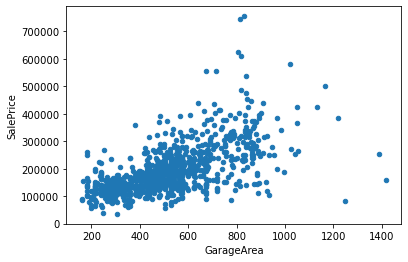

In [19]:
# Graph1 that shows the relationship between garage area and sale price
g1 = garage_dataset.plot.scatter(x='GarageArea', y= 'SalePrice')


<AxesSubplot:xlabel='GarageArea', ylabel='SalePrice'>

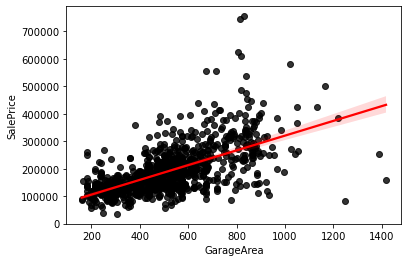

In [27]:
# I have used seaborn to show the same Graph1
# I have provided the graph with the line of best fit, which can use further to generate the gradient
# which will give us a better idea of the relationship between garage area and sale price
# Should we get rid of some data(anomalies)?
import seaborn as sn
sns.regplot(x = garage_dataset['GarageArea'],y = garage_dataset['SalePrice'],scatter_kws={"color": "black"}
            ,line_kws={"color": "red"})

In [44]:
# Separate the data into two datasets: one with under 1400 total sqft above ground level and one with under 1400
# For each year in the dataset an average of the sqft and price will be computed
# The two dataset are then going to be used to compared to the year built
# With this graph we can see how the prices of houses over/under 1400 sqft progressed thoughout the years
# Therefore we can see how the prices progressed throughout the years and how sqft affect the prices

# DataFrame for over 1400 sqft
df_over_1400= houseprice.drop(['LotFrontage', 'OverallQual','YearRemodAdd','MasVnrType','MasVnrArea','ExterQual',
                                    'Foundation','BsmtQual','BsmtFinSF1','TotalBsmtSF','HeatingQC', '1stFlrSF','2ndFlrSF',
                                    'KitchenQual','TotRmsAbvGrd', 'Fireplaces', 'OpenPorchSF','WoodDeckSF', 'GarageFinish','GarageCars',
                                     'GarageYrBlt', 'FullBath', 'GarageArea'],axis = 1)
df_over_1400= df_over_1400.drop(df_over_1400[df_over_1400.GrLivArea < 1400].index)

# DataFrame for under 1400 sqft
df_under_1400= houseprice.drop(['LotFrontage', 'OverallQual','YearRemodAdd','MasVnrType','MasVnrArea','ExterQual',
                                    'Foundation','BsmtQual','BsmtFinSF1','TotalBsmtSF','HeatingQC', '1stFlrSF','2ndFlrSF',
                                    'KitchenQual','TotRmsAbvGrd', 'Fireplaces', 'OpenPorchSF','WoodDeckSF', 'GarageFinish','GarageCars',
                                     'GarageYrBlt', 'FullBath', 'GarageArea'],axis = 1)
df_under_1400= df_under_1400.drop(df_under_1400[df_under_1400.GrLivArea > 1400].index)

# Compute the average for over 1400 sqft
df_over_1400 = df_over_1400.groupby('YearBuilt').mean().reset_index()

# Compute the average for under 1400 sqft
df_under_1400 = df_under_1400.groupby('YearBuilt').mean().reset_index()


df_under_1400






,YearBuilt,GrLivArea,SalePrice
0,1885,1047.000000,100000.000000
1,1900,1272.500000,110888.000000
2,1908,1252.000000,127000.000000
3,1910,1263.166667,114334.000000
4,1913,694.000000,90350.000000
5,1914,864.000000,58500.000000
6,1915,1305.000000,129287.500000
7,1916,1270.000000,103950.000000
8,1918,1044.000000,123000.000000
9,1920,1099.333333,99350.000000


In [50]:
# Plot a bar chart showing how houses, with over 1400 sqft above ground area, have cost over the years g
g2 = px.bar(df_over_1400, x= 'YearBuilt', y= 'SalePrice' )
g2

In [51]:
# Plot a bar chart showing how houses, with under 1400 sqft above ground area, have cost over the years g
g3 = px.bar(df_over_1400, x= 'YearBuilt', y= 'SalePrice' )
g3

In [55]:
# Create the data frame to compare Sale Price to the year the house was remodeled
remodel_df = houseprice.drop(['LotFrontage', 'OverallQual','MasVnrType','MasVnrArea','ExterQual',
                                    'Foundation','BsmtQual','BsmtFinSF1','TotalBsmtSF','HeatingQC', '1stFlrSF','2ndFlrSF',
                                    'KitchenQual','TotRmsAbvGrd', 'Fireplaces', 'OpenPorchSF','WoodDeckSF', 'GarageFinish','GarageCars',
                                     'GarageYrBlt', 'FullBath', 'GarageArea','GrLivArea','YearBuilt'],axis = 1)
remodel_df







,YearRemodAdd,SalePrice
0,2003,208500.0
1,1976,181500.0
2,2002,223500.0
3,1970,140000.0
4,2000,250000.0
5,1995,143000.0
6,2005,307000.0
8,1950,129900.0
9,1950,118000.0
10,1965,129500.0


<AxesSubplot:xlabel='YearRemodAdd'>

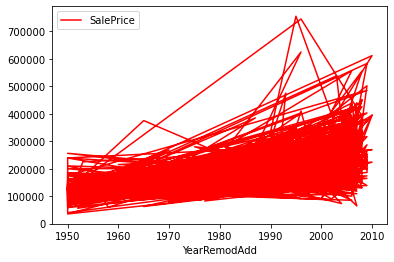

In [67]:
# Graph a line chart from the remodel_df

g4 = remodel_df.plot('YearRemodAdd', 'SalePrice', color= 'red')
g4

<AxesSubplot:xlabel='YearRemodAdd', ylabel='SalePrice'>

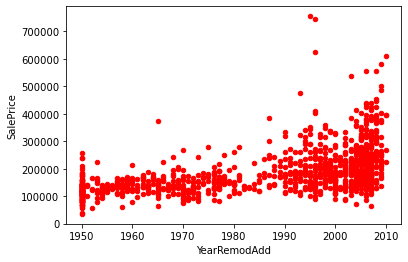

In [68]:
# Because of the graph being visually hard to read, Scatter graph is a better option
# Do you have any ideas on how to make the line graph easier to read Wanzhen? Maybe getting rid of some anomalies 
# like the 700 000 price house?
g5 = remodel_df.plot.scatter('YearRemodAdd', 'SalePrice', color= 'red')
g5

In [80]:
# Create a data frame with Masonry veneer type and the Sale price

mason_df = houseprice.drop(['LotFrontage', 'OverallQual','MasVnrArea','ExterQual',
                                    'Foundation','BsmtQual','BsmtFinSF1','TotalBsmtSF','HeatingQC', '1stFlrSF','2ndFlrSF',
                                    'KitchenQual','TotRmsAbvGrd', 'Fireplaces', 'OpenPorchSF','WoodDeckSF', 'GarageFinish','GarageCars',
                                     'GarageYrBlt', 'FullBath', 'GarageArea','GrLivArea','YearBuilt','YearRemodAdd'],axis = 1)


# Compute the average for each category in mason_df
mason_df = mason_df.groupby('MasVnrType').mean().reset_index()

mason_df




,MasVnrType,SalePrice
0,0.0,160307.620312
1,1.0,210747.075988
2,2.0,269796.252101
3,3.0,135552.333333


In [83]:
# Plot a bar chart showing how houses, with different Masonry veneer type cost, to find out what material 
# turns out to be the most expensive
# Legend : 'None':0,'BrkFace':1,'Stone':2,'BrkCmn':3,'CBlock':4
# Should we undummify the MasVnrType?
g6 = px.bar(mason_df, x= 'MasVnrType', y= 'SalePrice' )
g6